## Importing required libraries

In [1]:
import pandas as pd
import numpy as np
import json
import xmltodict
import datetime
import os
import matplotlib
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as py
import seaborn as sns

## Loading dataframes

In [2]:
datafilenamepath = "C:\\Users\\edidd\\Documents\\Ubiqum\\Data Analytics Course\\Project_Heike2\\Data"

In [3]:
df_397_1 = pd.read_csv(os.path.join(datafilenamepath, "397_df_2019_10_12.csv"))

In [4]:
df_397_2 = pd.read_csv(os.path.join(datafilenamepath, "397_df_2020_01.csv"))

In [5]:
df_397_3 = pd.read_csv(os.path.join(datafilenamepath, "397_df_2019-01_to_2019-09.csv"))

In [6]:
df_Texterior = pd.read_csv(os.path.join(datafilenamepath, "397_Tª exterior_2019-01-01_to_2019-09-30.csv"))

In [7]:
infoloc = pd.read_csv(os.path.join(datafilenamepath, "infoloc.csv"))

## Merging dataframes

In [8]:
df_397_2 = df_397_2.drop(["Paro - marcha", "Alarma", "Algoritmos", "Rooftop", "Energía Contador", "CO2", 
                          "Potencia General", "Tª SET invierno", "Tª SET verano"], axis= 1)

In [9]:
df_397_3 = df_397_3.drop(["Paro - marcha", "Alarma", "Algoritmos", "Rooftop", "Energía Contador", "CO2", 
                          "Potencia General", "Tª SET invierno", "Tª SET verano"], axis= 1)

In [65]:
df_397_1.shape

(26509, 21)

In [66]:
df_397_2.shape

(8954, 21)

In [10]:
df_397 = pd.concat([df_397_1, df_397_2, df_397_3], sort = True)

## Filling NAs with interpolation

### Preparing the data

In [11]:
df_397["datetime"] = pd.to_datetime(df_397["datetime"], format="%Y-%m-%d %H:%M:%S")

In [12]:
df_397["Filtro sucio"] = df_397["Filtro sucio"].apply(str)

In [13]:
df_397["Verano - invierno"] = df_397["Verano - invierno"].apply(str)

In [14]:
df_397["Verano - Invierno Tienda"] = df_397["Verano - Invierno Tienda"].apply(str)

In [15]:
df_397 = df_397.sort_values("datetime")

In [16]:
df_397 = df_397.reset_index()

In [17]:
df_397 = df_397.drop("index", axis = "columns")

In [18]:
df_397.shape

(117310, 21)

### Treating NAs

In [19]:
df_397.dtypes

% compuerta exterior               float64
Filtro sucio                        object
Humedad exterior                   float64
Humedad interior                   float64
Potencia Rooftop                   float64
Presión Alta C1                    float64
Presión Alta C2                    float64
Presión Alta C3                    float64
Presión Alta C4                    float64
Presión Baja C1                    float64
Presión Baja C2                    float64
Presión Baja C3                    float64
Presión Baja C4                    float64
Tª consigna activa                 float64
Tª exterior                        float64
Tª impulsión                       float64
Tª interior                        float64
Tª retorno                         float64
Verano - Invierno Tienda            object
Verano - invierno                   object
datetime                    datetime64[ns]
dtype: object

In [20]:
df_397.isnull().any().any()

True

In [21]:
df_397

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,Presión Baja C3,Presión Baja C4,Tª consigna activa,Tª exterior,Tª impulsión,Tª interior,Tª retorno,Verano - Invierno Tienda,Verano - invierno,datetime
0,0.0,1.0,62.1,28.8,0.36,9.79,9.61,9.96,10.22,9.67,...,10.01,10.13,24.0,8.9,16.0,22.4,12.8,1.0,1.0,2019-01-01 00:00:00
1,0.0,nan,62.2,29.1,0.36,9.79,9.67,10.02,10.13,9.73,...,9.91,10.12,NaN,9.0,16.0,22.4,12.8,nan,nan,2019-01-01 00:05:00
2,0.0,nan,62.4,29.0,0.36,9.85,9.67,9.82,10.24,9.73,...,10.18,10.01,24.0,9.0,16.1,22.4,12.8,1.0,nan,2019-01-01 00:10:00
3,0.0,1.0,62.2,28.9,0.32,9.85,9.67,9.94,10.08,9.73,...,9.87,10.16,NaN,9.0,16.2,22.4,12.8,nan,1.0,2019-01-01 00:15:00
4,0.0,nan,62.6,29.0,0.28,9.85,9.73,9.91,10.25,9.79,...,9.96,9.99,24.0,9.0,16.3,22.3,12.8,1.0,nan,2019-01-01 00:20:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117305,0.0,nan,86.5,41.1,0.36,11.52,11.45,11.20,11.53,11.39,...,11.39,11.36,NaN,13.1,18.6,23.5,16.9,nan,nan,2020-01-31 23:40:00
117306,0.0,0.0,86.7,41.2,0.36,11.52,11.39,11.23,11.59,11.39,...,11.50,11.36,NaN,13.1,18.5,23.4,16.8,nan,0.0,2020-01-31 23:45:00
117307,0.0,nan,87.0,41.0,0.32,11.45,11.33,11.28,11.28,11.33,...,11.34,11.33,24.0,12.8,18.1,23.4,16.8,1.0,nan,2020-01-31 23:50:00
117308,0.0,nan,87.8,41.0,0.32,11.39,11.33,11.15,11.25,11.27,...,11.42,11.34,NaN,12.7,18.1,23.4,16.5,nan,nan,2020-01-31 23:55:00


### Dropping rows with only NAs

In [331]:
df_index = df_397.index[df_397.loc[:, df_397.columns != "datetime"].isnull().all(1)]

In [332]:
df_397 = df_397.drop(df_index)

### Interpolating linear

In [22]:
df_397 = df_397.interpolate(method='linear', limit_direction='forward', axis=0)

In [23]:
df_397

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,Presión Baja C3,Presión Baja C4,Tª consigna activa,Tª exterior,Tª impulsión,Tª interior,Tª retorno,Verano - Invierno Tienda,Verano - invierno,datetime
0,0.0,1.0,62.1,28.8,0.36,9.79,9.61,9.96,10.22,9.67,...,10.01,10.13,24.000000,8.9,16.0,22.4,12.8,1.0,1.0,2019-01-01 00:00:00
1,0.0,nan,62.2,29.1,0.36,9.79,9.67,10.02,10.13,9.73,...,9.91,10.12,24.000000,9.0,16.0,22.4,12.8,nan,nan,2019-01-01 00:05:00
2,0.0,nan,62.4,29.0,0.36,9.85,9.67,9.82,10.24,9.73,...,10.18,10.01,24.000000,9.0,16.1,22.4,12.8,1.0,nan,2019-01-01 00:10:00
3,0.0,1.0,62.2,28.9,0.32,9.85,9.67,9.94,10.08,9.73,...,9.87,10.16,24.000000,9.0,16.2,22.4,12.8,nan,1.0,2019-01-01 00:15:00
4,0.0,nan,62.6,29.0,0.28,9.85,9.73,9.91,10.25,9.79,...,9.96,9.99,24.000000,9.0,16.3,22.3,12.8,1.0,nan,2019-01-01 00:20:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117305,0.0,nan,86.5,41.1,0.36,11.52,11.45,11.20,11.53,11.39,...,11.39,11.36,24.083333,13.1,18.6,23.5,16.9,nan,nan,2020-01-31 23:40:00
117306,0.0,0.0,86.7,41.2,0.36,11.52,11.39,11.23,11.59,11.39,...,11.50,11.36,24.041667,13.1,18.5,23.4,16.8,nan,0.0,2020-01-31 23:45:00
117307,0.0,nan,87.0,41.0,0.32,11.45,11.33,11.28,11.28,11.33,...,11.34,11.33,24.000000,12.8,18.1,23.4,16.8,1.0,nan,2020-01-31 23:50:00
117308,0.0,nan,87.8,41.0,0.32,11.39,11.33,11.15,11.25,11.27,...,11.42,11.34,24.000000,12.7,18.1,23.4,16.5,nan,nan,2020-01-31 23:55:00


### Filling categorical NA's with previos value

In [24]:
df_397 = df_397.replace("nan", np.nan)

In [25]:
df_397 = df_397.fillna(method='ffill')

In [26]:
df_397

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,Presión Baja C3,Presión Baja C4,Tª consigna activa,Tª exterior,Tª impulsión,Tª interior,Tª retorno,Verano - Invierno Tienda,Verano - invierno,datetime
0,0.0,1.0,62.1,28.8,0.36,9.79,9.61,9.96,10.22,9.67,...,10.01,10.13,24.000000,8.9,16.0,22.4,12.8,1.0,1.0,2019-01-01 00:00:00
1,0.0,1.0,62.2,29.1,0.36,9.79,9.67,10.02,10.13,9.73,...,9.91,10.12,24.000000,9.0,16.0,22.4,12.8,1.0,1.0,2019-01-01 00:05:00
2,0.0,1.0,62.4,29.0,0.36,9.85,9.67,9.82,10.24,9.73,...,10.18,10.01,24.000000,9.0,16.1,22.4,12.8,1.0,1.0,2019-01-01 00:10:00
3,0.0,1.0,62.2,28.9,0.32,9.85,9.67,9.94,10.08,9.73,...,9.87,10.16,24.000000,9.0,16.2,22.4,12.8,1.0,1.0,2019-01-01 00:15:00
4,0.0,1.0,62.6,29.0,0.28,9.85,9.73,9.91,10.25,9.79,...,9.96,9.99,24.000000,9.0,16.3,22.3,12.8,1.0,1.0,2019-01-01 00:20:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117305,0.0,0.0,86.5,41.1,0.36,11.52,11.45,11.20,11.53,11.39,...,11.39,11.36,24.083333,13.1,18.6,23.5,16.9,1.0,0.0,2020-01-31 23:40:00
117306,0.0,0.0,86.7,41.2,0.36,11.52,11.39,11.23,11.59,11.39,...,11.50,11.36,24.041667,13.1,18.5,23.4,16.8,1.0,0.0,2020-01-31 23:45:00
117307,0.0,0.0,87.0,41.0,0.32,11.45,11.33,11.28,11.28,11.33,...,11.34,11.33,24.000000,12.8,18.1,23.4,16.8,1.0,0.0,2020-01-31 23:50:00
117308,0.0,0.0,87.8,41.0,0.32,11.39,11.33,11.15,11.25,11.27,...,11.42,11.34,24.000000,12.7,18.1,23.4,16.5,1.0,0.0,2020-01-31 23:55:00


In [27]:
df_397.isnull().any().any()

False

## Changing data types

In [28]:
df_397.dtypes

% compuerta exterior               float64
Filtro sucio                        object
Humedad exterior                   float64
Humedad interior                   float64
Potencia Rooftop                   float64
Presión Alta C1                    float64
Presión Alta C2                    float64
Presión Alta C3                    float64
Presión Alta C4                    float64
Presión Baja C1                    float64
Presión Baja C2                    float64
Presión Baja C3                    float64
Presión Baja C4                    float64
Tª consigna activa                 float64
Tª exterior                        float64
Tª impulsión                       float64
Tª interior                        float64
Tª retorno                         float64
Verano - Invierno Tienda            object
Verano - invierno                   object
datetime                    datetime64[ns]
dtype: object

In [29]:
df_397["Verano - invierno"] = df_397["Verano - invierno"].astype("category")

In [30]:
df_397["Verano - Invierno Tienda"] = df_397["Verano - Invierno Tienda"].astype("category")

In [31]:
df_397["Filtro sucio"] = df_397["Filtro sucio"].astype("category")

In [32]:
df_397["Verano - Invierno Tienda"]

0         1.0
1         1.0
2         1.0
3         1.0
4         1.0
         ... 
117305    1.0
117306    1.0
117307    1.0
117308    1.0
117309    1.0
Name: Verano - Invierno Tienda, Length: 117310, dtype: category
Categories (1, object): [1.0]

In [33]:
df_397["Filtro sucio"][0]

'1.0'

In [34]:
df_397.dtypes

% compuerta exterior               float64
Filtro sucio                      category
Humedad exterior                   float64
Humedad interior                   float64
Potencia Rooftop                   float64
Presión Alta C1                    float64
Presión Alta C2                    float64
Presión Alta C3                    float64
Presión Alta C4                    float64
Presión Baja C1                    float64
Presión Baja C2                    float64
Presión Baja C3                    float64
Presión Baja C4                    float64
Tª consigna activa                 float64
Tª exterior                        float64
Tª impulsión                       float64
Tª interior                        float64
Tª retorno                         float64
Verano - Invierno Tienda          category
Verano - invierno                 category
datetime                    datetime64[ns]
dtype: object

## Feature engineering

In [35]:
df_397.describe()

,% compuerta exterior,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,Presión Baja C2,Presión Baja C3,Presión Baja C4,Tª consigna activa,Tª exterior,Tª impulsión,Tª interior,Tª retorno
count,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000
mean,7.197980,70.434216,38.384893,15.527365,14.535229,12.662846,14.305504,14.517026,11.712675,12.657718,11.589303,12.091401,24.209767,19.302265,19.152816,24.310745,20.502049
std,16.056346,16.781413,8.182011,24.508484,5.319784,2.139717,5.484986,4.797534,2.752258,2.120104,2.613963,2.418999,0.471040,7.712113,4.510851,1.652737,5.639072
min,0.000000,22.700000,15.200000,-0.080000,4.310000,7.270000,3.970000,7.520000,2.280000,3.820000,2.260000,4.020000,23.000000,0.700000,3.200000,19.800000,6.100000
25%,0.000000,57.300000,32.300000,0.320000,11.020000,10.960000,10.860000,11.330000,9.980000,11.020000,10.010000,10.250000,24.000000,13.100000,15.600000,23.100000,15.900000
50%,0.000000,71.700000,39.000000,0.360000,13.050000,12.320000,12.480000,13.280000,11.580000,12.320000,11.470000,12.030000,24.000000,18.900000,18.300000,24.400000,22.000000
75%,5.000000,88.500000,44.100000,25.640000,15.270000,14.470000,14.800000,15.240000,13.920000,14.470000,13.483750,14.100000,24.600000,24.600000,22.700000,25.500000,24.000000
max,100.000000,89.900000,64.400000,108.360000,33.990000,28.450000,34.950000,33.600000,21.000000,19.640000,21.430000,19.640000,25.450000,45.200000,42.400000,28.300000,49.500000


Droping "Verano - Invierno Tienda" vor having 0 variance

In [86]:
df_397 = df_397.drop("Verano - Invierno Tienda", axis = "columns")

### Engineering features and dependent variable

In [36]:
df_397["DT clima-interior"] = df_397["Tª impulsión"]/2 + df_397["Tª retorno"]/2 - df_397["Tª interior"]

In [37]:
df_397["DT impulsion-retorno"] = df_397["Tª impulsión"] - df_397["Tª retorno"]

In [38]:
df_397["DT exterior-interior"] = df_397["Tª exterior"] - df_397["Tª interior"]

In [39]:
df_397["DT exterior4-interior4"] = (df_397["Tª exterior"] + 273.15) ** 4 - (df_397["Tª interior"] + 273.15) ** 4

In [45]:
df_397["DP1"] = df_397["Presión Alta C1"] - df_397["Presión Baja C1"]

In [46]:
df_397["DP2"] = df_397["Presión Alta C2"] - df_397["Presión Baja C2"]

In [47]:
df_397["DP3"] = df_397["Presión Alta C3"] - df_397["Presión Baja C3"]

In [48]:
df_397["DP4"] = df_397["Presión Alta C4"] - df_397["Presión Baja C4"]

In [40]:
df_397.datetime[0]

Timestamp('2019-01-01 00:00:00')

In [396]:
type(df_397.datetime[0])

pandas._libs.tslibs.timestamps.Timestamp

In [102]:
a= df_397.datetime[1] - df_397.datetime[0]

In [106]:
type(a)

pandas._libs.tslibs.timedeltas.Timedelta

In [107]:
a.total_seconds()

300.0

In [109]:
df_397["DT clima-interior"]/a.total_seconds()

0       -0.012333
1       -0.012500
2       -0.013000
3       -0.013167
4       -0.013333
           ...   
35458   -0.019167
35459   -0.019167
35460   -0.019833
35461   -0.020333
35462   -0.020333
Name: DT clima-interior, Length: 35463, dtype: float64

## Creating dependent variable

In [41]:
df_397["DT interior"] = (df_397["Tª interior"].shift(-1) - df_397["Tª interior"])

In [42]:
df_397["DT interior"] = df_397["DT interior"].fillna(method= "ffill")

In [43]:
df_397.isnull().any().any()

False

In [126]:
#df_397["DT/dt interior"] = (df_397["Tª interior"].shift(-1) - df_397["Tª interior"]) / (df_397["datetime"].shift(-1) - df_397["datetime"]).total_seconds()

AttributeError: 'Series' object has no attribute 'total_seconds'

In [78]:
df_397.columns

Index(['% compuerta exterior', 'Filtro sucio', 'Humedad exterior',
       'Humedad interior', 'Potencia Rooftop', 'Presión Alta C1',
       'Presión Alta C2', 'Presión Alta C3', 'Presión Alta C4',
       'Presión Baja C1', 'Presión Baja C2', 'Presión Baja C3',
       'Presión Baja C4', 'Tª consigna activa', 'Tª exterior', 'Tª impulsión',
       'Tª interior', 'Tª retorno', 'Verano - Invierno Tienda',
       'Verano - invierno', 'datetime', 'DT clima-interior',
       'DT exterior-interior', 'DT exterior4-interior4', 'DT interior'],
      dtype='object')

In [107]:
df_397.describe()

,% compuerta exterior,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,Presión Baja C2,...,Tª retorno,DT clima-interior,DT impulsion-retorno,DT exterior-interior,DT exterior4-interior4,DT interior,DP1,DP2,DP3,DP4
count,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,...,117310.000000,117310.000000,117310.000000,117310.000000,1.173100e+05,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000
mean,7.197980,70.434216,38.384893,15.527365,14.535229,12.662846,14.305504,14.517026,11.712675,12.657718,...,20.502049,-4.483313,-1.349233,-5.008481,-4.848792e+08,0.000009,2.822554,0.005128,2.716202,2.425625
std,16.056346,16.781413,8.182011,24.508484,5.319784,2.139717,5.484986,4.797534,2.752258,2.120104,...,5.639072,3.785539,4.702066,6.738949,6.838602e+08,0.046946,6.731215,0.718219,6.803596,5.814604
min,0.000000,22.700000,15.200000,-0.080000,4.310000,7.270000,3.970000,7.520000,2.280000,3.820000,...,6.100000,-13.650000,-18.300000,-19.800000,-1.813510e+09,-0.900000,-0.130000,-0.310000,-0.480000,-0.588548
25%,0.000000,57.300000,32.300000,0.320000,11.020000,10.960000,10.860000,11.330000,9.980000,11.020000,...,15.900000,-7.150000,-4.100000,-10.487500,-1.035543e+09,0.000000,0.060000,-0.060000,-0.160000,-0.030000
50%,0.000000,71.700000,39.000000,0.360000,13.050000,12.320000,12.480000,13.280000,11.580000,12.320000,...,22.000000,-5.100000,0.700000,-5.600000,-5.758250e+08,0.000000,0.060000,0.000000,-0.020000,0.100000
75%,5.000000,88.500000,44.100000,25.640000,15.270000,14.470000,14.800000,15.240000,13.920000,14.470000,...,24.000000,-2.200000,1.900000,-0.700000,-7.387460e+07,0.000000,0.120000,0.000000,0.110000,0.220000
max,100.000000,89.900000,64.400000,108.360000,33.990000,28.450000,34.950000,33.600000,21.000000,19.640000,...,49.500000,18.250000,6.200000,19.900000,2.337265e+09,0.500000,26.790000,20.260000,27.330000,24.360000


## Scatter plots

Sub-setting the data

In [51]:
day_20191001 = df_397[(df_397.datetime.dt.month == 10) & (df_397.datetime.dt.day == 1)]

In [52]:
abierto_20191001 = df_397[(df_397.datetime.dt.month == 10) & (df_397.datetime.dt.day == 1) & (df_397.datetime.dt.hour >= 9) & (df_397.datetime.dt.hour <= 21)]

In [53]:
cerrado_20191001 = df_397[(df_397.datetime.dt.month == 10) & (df_397.datetime.dt.day == 1) & ((df_397.datetime.dt.hour < 9) | (df_397.datetime.dt.hour > 21))]

In [54]:
week_201910w1 = df_397[(df_397.datetime.dt.week == 1)]

In [55]:
month_201910 = df_397[(df_397.datetime.dt.month == 10)]

In [56]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_397["datetime"], 
                        y= df_397["Verano - invierno"],
                        mode = "lines",
                        name = "Verano - invierno"))
fig.update_layout(
    title="Verano - invierno")
fig.show()

In [57]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_397["datetime"], 
                        y= df_397["Filtro sucio"],
                        mode = "lines",
                        name = "Verano - invierno"))
fig.update_layout(
    title="Filtro sucio")
fig.show()

In [58]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_397["datetime"], 
                        y= df_397["% compuerta exterior"],
                        mode = "lines",
                        name = "Verano - invierno"))
fig.update_layout(
    title="%compuerta exterior")
fig.show()

## Correlation plot using seaborn pairplot

In [416]:
corr_var_week = week_201910w1[["Potencia Rooftop", "DT clima-interior", "DT exterior-interior", "Tª impulsión", "Tª exterior", "Tª interior", "DT interior", "% compuerta exterior"]]

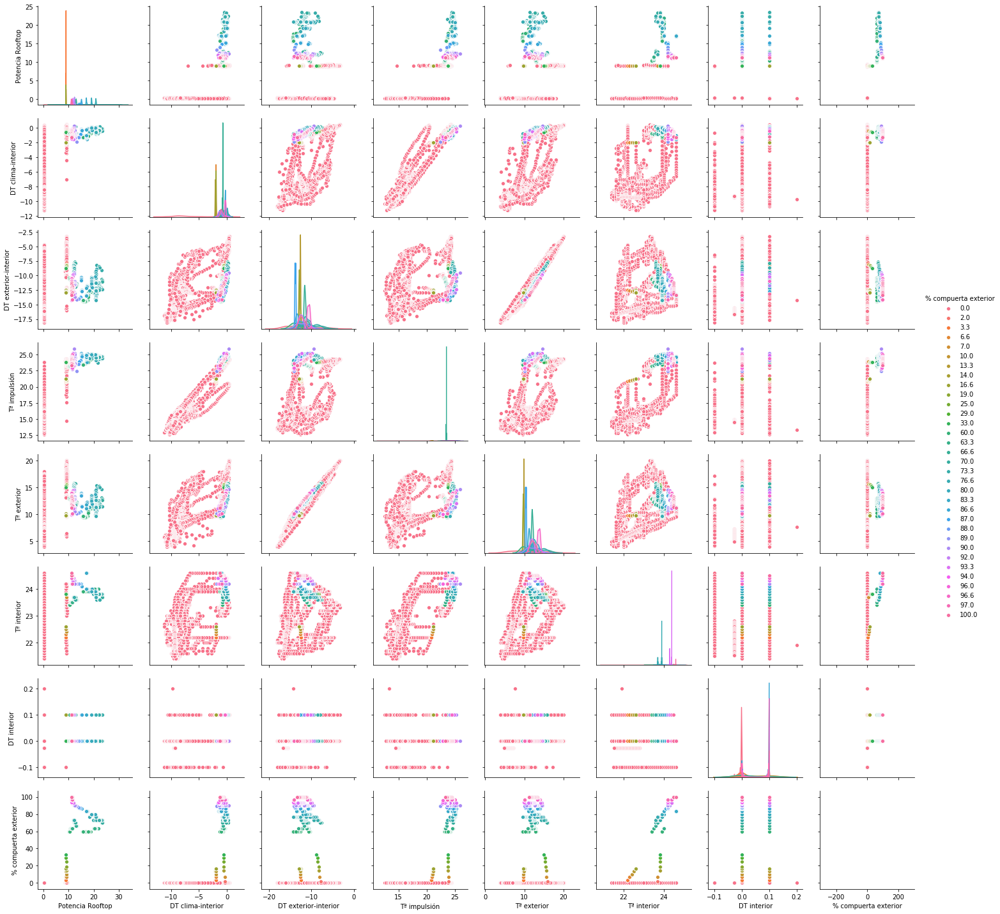

In [421]:
sns.pairplot(corr_var_week, hue= "% compuerta exterior", palette="husl")

In [414]:
corr_var_day = day_20191001[["Potencia Rooftop", "DT clima-interior", "DT exterior-interior", "Tª impulsión", "Tª exterior", "Tª interior", "DT interior", "% compuerta exterior"]]

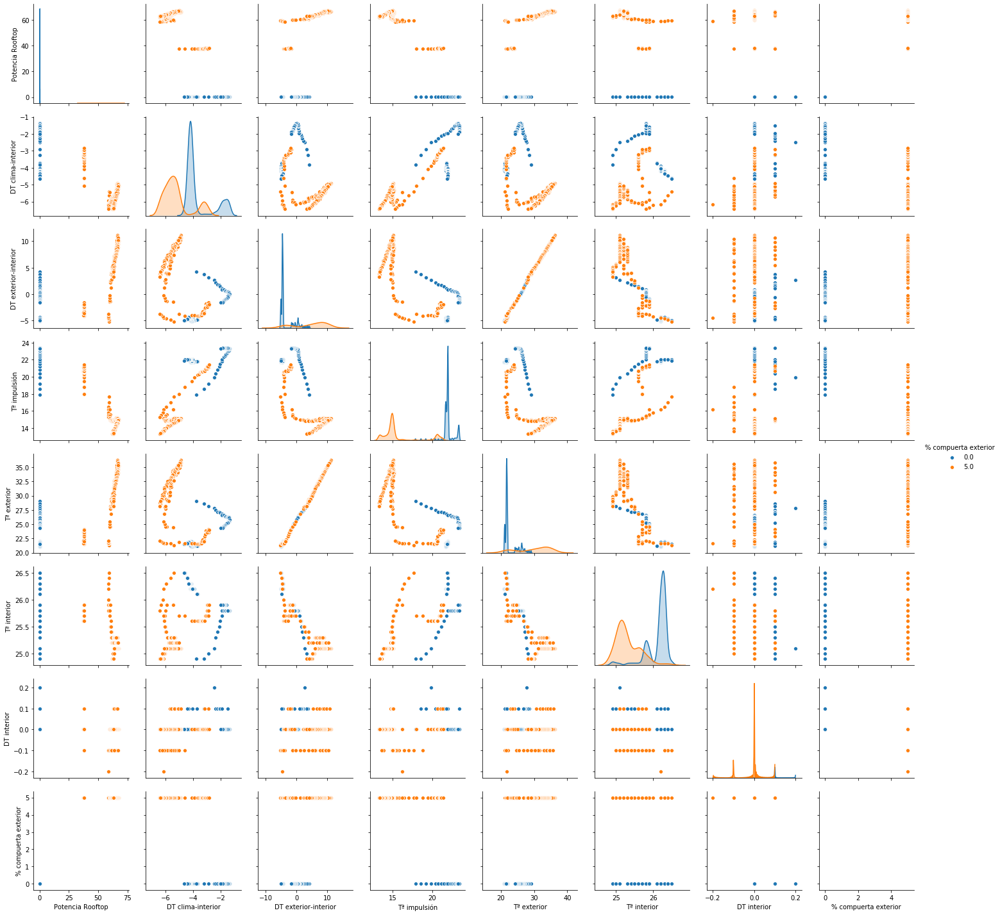

In [420]:
sns.pairplot(corr_var_day, hue= "% compuerta exterior")

## Other dates

In [12]:
df_Texterior.head(10)

,valor,data,hora,ps_id
0,8.9,2019-01-01,00:00:00,13
1,9.0,2019-01-01,00:05:00,13
2,9.0,2019-01-01,00:10:00,13
3,9.0,2019-01-01,00:15:00,13
4,9.0,2019-01-01,00:20:00,13
5,9.0,2019-01-01,00:25:00,13
6,9.1,2019-01-01,00:30:00,13
7,9.0,2019-01-01,00:35:00,13
8,8.9,2019-01-01,00:40:00,13
9,8.8,2019-01-01,00:45:00,13


In [13]:
df_Texterior.tail(10)

,valor,data,hora,ps_id
78376,21.9,2019-09-30,23:10:00,13
78377,21.9,2019-09-30,23:15:00,13
78378,21.8,2019-09-30,23:20:00,13
78379,21.7,2019-09-30,23:25:00,13
78380,21.7,2019-09-30,23:30:00,13
78381,21.6,2019-09-30,23:35:00,13
78382,21.6,2019-09-30,23:40:00,13
78383,21.6,2019-09-30,23:45:00,13
78384,21.4,2019-09-30,23:50:00,13
78385,21.4,2019-09-30,23:55:00,13


## Pre-processing data: filtering only data of power on/off

### Fetching power limits from "infoloc"

In [69]:
power_on = infoloc.loc[infoloc.id == 397, "pot_arranque"]

In [75]:
power_on = infoloc["pot_arranque"][infoloc.id == 397]

In [49]:
power_on = 23

In [50]:
power_on.values

AttributeError: 'int' object has no attribute 'values'

In [51]:
power_off = infoloc.loc[infoloc.id == 397, "pot_parada"]

In [52]:
power_off.values

array([2.])

### Looking at the Dp's of the compressors

#### Distributions

In [53]:
fig = go.Figure(data= [go.Histogram(x= df_397["DT interior"])])
fig.update_layout(
    title="Freq - DT interior",
    xaxis_title="DT interior")
fig.show()

In [58]:
fig = go.Figure(data= [go.Histogram(x= df_397["DP4"])])
fig.update_layout(
    title="Freq - DPresion 4",
    xaxis_title="DP4")
fig.show()

In [59]:
df_397.describe()

,% compuerta exterior,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,Presión Baja C2,...,Tª retorno,DT clima-interior,DT impulsion-retorno,DT exterior-interior,DT exterior4-interior4,DT interior,DP1,DP2,DP3,DP4
count,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000,...,117310.000000,117310.000000,117310.000000,117310.000000,1.173100e+05,117310.000000,117310.000000,117310.000000,117310.000000,117310.000000
mean,7.197980,70.434216,38.384893,15.527365,14.535229,12.662846,14.305504,14.517026,11.712675,12.657718,...,20.502049,-4.483313,-1.349233,-5.008481,-4.848792e+08,0.000009,2.822554,0.005128,2.716202,2.425625
std,16.056346,16.781413,8.182011,24.508484,5.319784,2.139717,5.484986,4.797534,2.752258,2.120104,...,5.639072,3.785539,4.702066,6.738949,6.838602e+08,0.046946,6.731215,0.718219,6.803596,5.814604
min,0.000000,22.700000,15.200000,-0.080000,4.310000,7.270000,3.970000,7.520000,2.280000,3.820000,...,6.100000,-13.650000,-18.300000,-19.800000,-1.813510e+09,-0.900000,-0.130000,-0.310000,-0.480000,-0.588548
25%,0.000000,57.300000,32.300000,0.320000,11.020000,10.960000,10.860000,11.330000,9.980000,11.020000,...,15.900000,-7.150000,-4.100000,-10.487500,-1.035543e+09,0.000000,0.060000,-0.060000,-0.160000,-0.030000
50%,0.000000,71.700000,39.000000,0.360000,13.050000,12.320000,12.480000,13.280000,11.580000,12.320000,...,22.000000,-5.100000,0.700000,-5.600000,-5.758250e+08,0.000000,0.060000,0.000000,-0.020000,0.100000
75%,5.000000,88.500000,44.100000,25.640000,15.270000,14.470000,14.800000,15.240000,13.920000,14.470000,...,24.000000,-2.200000,1.900000,-0.700000,-7.387460e+07,0.000000,0.120000,0.000000,0.110000,0.220000
max,100.000000,89.900000,64.400000,108.360000,33.990000,28.450000,34.950000,33.600000,21.000000,19.640000,...,49.500000,18.250000,6.200000,19.900000,2.337265e+09,0.500000,26.790000,20.260000,27.330000,24.360000


In [63]:
test = df_397.loc[(df_397["Potencia Rooftop"] >= 23), :]

In [108]:
test2 = df_397[(df_397["Potencia Rooftop"] >= 25) & (df_397["Potencia Rooftop"].shift(1) < 25)]

In [101]:
df_397_2019_01_04 = df_397.loc[df_397.datetime.dt.date.apply(str) == "2019-01-04", :]

In [102]:
df_397_2019_01_04

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,datetime,DT clima-interior,DT impulsion-retorno,DT exterior-interior,DT exterior4-interior4,DT interior,DP1,DP2,DP3,DP4
870,0.0,0.0,89.9,35.0,0.36,9.48,9.42,9.240,9.54,9.48,...,2019-01-04 00:00:00,-8.250,2.50,-15.4,-1.474846e+09,-0.10,0.00,0.000,-0.21,0.03
871,0.0,0.0,89.9,35.1,0.28,9.48,9.42,9.290,9.53,9.42,...,2019-01-04 00:05:00,-8.250,2.50,-15.4,-1.473311e+09,0.00,0.06,0.060,-0.14,-0.10
872,0.0,0.0,89.9,35.5,0.32,9.42,9.42,9.380,9.57,9.42,...,2019-01-04 00:10:00,-8.350,2.70,-15.5,-1.482121e+09,0.00,0.00,0.060,0.09,0.15
873,0.0,0.0,89.9,35.4,0.32,9.42,9.36,9.310,9.68,9.36,...,2019-01-04 00:15:00,-8.400,2.80,-15.6,-1.490920e+09,-0.10,0.06,0.000,0.08,0.17
874,0.0,0.0,89.9,35.4,0.36,9.42,9.36,9.200,9.59,9.36,...,2019-01-04 00:20:00,-8.450,2.70,-15.5,-1.480578e+09,0.00,0.06,0.060,-0.33,0.21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1155,0.0,0.0,89.9,35.4,0.32,9.30,9.24,9.240,9.32,9.24,...,2019-01-04 23:40:00,-8.000,3.00,-16.1,-1.536377e+09,0.00,0.06,0.000,0.02,-0.14
1156,0.0,0.0,89.9,35.4,0.32,9.30,9.30,9.260,9.49,9.24,...,2019-01-04 23:45:00,-8.150,3.10,-16.1,-1.536377e+09,0.00,0.06,0.120,0.06,0.04
1157,0.0,0.0,89.9,35.2,0.36,9.30,9.24,9.110,9.54,9.24,...,2019-01-04 23:50:00,-8.250,2.90,-16.1,-1.536377e+09,0.00,0.06,0.060,0.02,0.22
1158,0.0,0.0,89.9,35.1,0.36,9.30,9.24,9.110,9.26,9.24,...,2019-01-04 23:55:00,-8.400,3.20,-16.2,-1.545130e+09,-0.05,0.06,0.060,-0.07,-0.14


In [105]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_397_2019_01_04["datetime"], 
                        y= df_397_2019_01_04["Potencia Rooftop"],
                        mode = "lines",
                        name = "Potencia Rooftop"))
fig.add_trace(go.Scatter(x= df_397_2019_01_04["datetime"], 
                        y= df_397_2019_01_04["DP1"],
                        mode = "lines",
                        name = "DP1"))
fig.add_trace(go.Scatter(x= df_397_2019_01_04["datetime"], 
                        y= df_397_2019_01_04["DP2"],
                        mode = "lines",
                        name = "DP2"))
fig.add_trace(go.Scatter(x= df_397_2019_01_04["datetime"], 
                        y= df_397_2019_01_04["DP3"],
                        mode = "lines",
                        name = "DP3"))
fig.add_trace(go.Scatter(x= df_397_2019_01_04["datetime"], 
                        y= df_397_2019_01_04["DP4"],
                        mode = "lines",
                        name = "DP4"))
fig.update_layout(
    title="Potencia Rooftop")
fig.show()

In [110]:
df_397_2019_01_07 = df_397.loc[df_397.datetime.dt.date.apply(str) == "2019-01-07", :]

In [111]:
df_397_2019_01_07

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,datetime,DT clima-interior,DT impulsion-retorno,DT exterior-interior,DT exterior4-interior4,DT interior,DP1,DP2,DP3,DP4
1737,0.0,0.0,55.7,22.9,0.36,9.48,9.48,9.37,9.54,9.48,...,2019-01-07 00:00:00,-8.100,3.80,-13.1,-1.243265e+09,0.0,0.00,0.06,-0.090,-0.09
1738,0.0,0.0,55.7,23.0,0.36,9.48,9.48,9.49,9.82,9.48,...,2019-01-07 00:05:00,-8.050,3.90,-13.1,-1.243265e+09,0.0,0.00,0.06,0.030,0.15
1739,0.0,0.0,55.9,23.0,0.36,9.48,9.48,9.42,9.67,9.42,...,2019-01-07 00:10:00,-8.100,3.80,-13.2,-1.252112e+09,0.0,0.06,0.06,-0.170,0.13
1740,0.0,0.0,55.7,22.9,0.36,9.48,9.42,9.29,9.62,9.42,...,2019-01-07 00:15:00,-8.100,3.80,-13.2,-1.252112e+09,0.0,0.06,0.06,-0.330,0.13
1741,0.0,0.0,56.2,22.8,0.28,9.42,9.42,9.29,9.51,9.42,...,2019-01-07 00:20:00,-8.250,3.50,-13.5,-1.278596e+09,0.0,0.00,0.06,-0.080,-0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022,0.0,0.0,89.9,33.3,0.28,9.79,9.73,9.74,9.88,9.73,...,2019-01-07 23:40:00,-8.050,2.10,-14.1,-1.355114e+09,-0.1,0.06,0.00,-0.030,0.00
2023,0.0,0.0,89.9,33.3,0.36,9.79,9.79,9.59,10.12,9.73,...,2019-01-07 23:45:00,-8.050,2.30,-14.0,-1.344793e+09,0.0,0.06,0.06,-0.060,0.24
2024,0.0,0.0,89.9,33.4,0.36,9.73,9.73,9.54,9.80,9.67,...,2019-01-07 23:50:00,-8.100,2.40,-14.1,-1.353706e+09,0.0,0.06,0.06,-0.160,-0.07
2025,0.0,0.0,89.9,33.4,0.32,9.73,9.73,9.37,10.04,9.61,...,2019-01-07 23:55:00,-8.050,2.50,-14.2,-1.362610e+09,0.0,0.12,0.06,-0.310,0.31


In [112]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_397_2019_01_07["datetime"], 
                        y= df_397_2019_01_07["Potencia Rooftop"],
                        mode = "lines",
                        name = "Potencia Rooftop"))
fig.add_trace(go.Scatter(x= df_397_2019_01_07["datetime"], 
                        y= df_397_2019_01_07["DP1"],
                        mode = "lines",
                        name = "DP1"))
fig.add_trace(go.Scatter(x= df_397_2019_01_07["datetime"], 
                        y= df_397_2019_01_07["DP2"],
                        mode = "lines",
                        name = "DP2"))
fig.add_trace(go.Scatter(x= df_397_2019_01_07["datetime"], 
                        y= df_397_2019_01_07["DP3"],
                        mode = "lines",
                        name = "DP3"))
fig.add_trace(go.Scatter(x= df_397_2019_01_07["datetime"], 
                        y= df_397_2019_01_07["DP4"],
                        mode = "lines",
                        name = "DP4"))
fig.update_layout(
    title="Potencia Rooftop")
fig.show()

In [109]:
test2

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,datetime,DT clima-interior,DT impulsion-retorno,DT exterior-interior,DT exterior4-interior4,DT interior,DP1,DP2,DP3,DP4
1901,77.0,0.0,38.2,21.8,34.08,15.09,15.09,12.48,12.96,14.96,...,2019-01-07 13:40:00,1.05,2.3,-4.1,-4.125418e+08,0.1,0.13,0.00,-0.09,0.00
8572,5.0,0.0,41.8,27.2,25.56,17.30,15.27,12.61,13.11,14.29,...,2019-01-30 15:15:00,0.05,0.9,-5.0,-5.069850e+08,0.0,3.01,0.00,-0.33,0.18
8575,3.0,0.0,42.5,27.2,29.80,19.46,18.47,28.12,12.93,11.21,...,2019-01-30 15:30:00,-1.60,-2.2,-5.0,-5.069850e+08,0.0,8.25,4.49,19.35,-0.09
11234,36.0,0.0,75.0,34.5,25.88,11.95,9.91,11.88,23.57,11.88,...,2019-02-08 19:55:00,-3.95,-3.3,-8.9,-8.901899e+08,0.0,0.07,0.12,-0.13,15.80
11518,17.0,0.0,61.7,32.1,26.16,12.44,9.91,12.35,24.46,12.44,...,2019-02-09 19:20:00,-4.25,-4.3,-7.3,-7.353560e+08,-0.1,0.00,0.06,-0.08,16.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107093,0.0,0.0,66.6,36.5,28.88,21.18,13.30,9.98,13.11,7.02,...,2019-12-27 14:35:00,-4.65,-7.3,-4.9,-5.016797e+08,0.0,14.16,0.00,-0.27,0.23
107134,0.0,0.0,65.0,37.9,29.52,11.15,14.96,21.99,13.42,10.47,...,2019-12-27 18:00:00,-4.30,-7.4,-4.8,-4.906899e+08,0.0,0.68,-0.07,15.00,0.00
107408,0.0,0.0,80.1,40.1,28.60,10.22,13.12,19.66,12.15,10.10,...,2019-12-28 16:45:00,-4.95,-7.3,-8.6,-8.668053e+08,0.0,0.12,-0.12,12.45,-0.04
107667,0.0,0.0,73.9,38.3,28.56,20.26,12.38,9.98,12.04,7.14,...,2019-12-29 14:15:00,-5.20,-7.4,-8.2,-8.273186e+08,0.0,13.12,0.00,-0.24,0.16


In [114]:
test4 = df_397[(df_397["DP1"] >= 5) | (df_397["DP2"] >= 5) | (df_397["DP3"] >= 5) | (df_397["DP4"] >= 5)]

In [115]:
test4

,% compuerta exterior,Filtro sucio,Humedad exterior,Humedad interior,Potencia Rooftop,Presión Alta C1,Presión Alta C2,Presión Alta C3,Presión Alta C4,Presión Baja C1,...,datetime,DT clima-interior,DT impulsion-retorno,DT exterior-interior,DT exterior4-interior4,DT interior,DP1,DP2,DP3,DP4
8575,3.000000,0.0,42.500000,27.200000,29.800000,19.460000,18.470,28.120000,12.930000,11.210000,...,2019-01-30 15:30:00,-1.600000,-2.200000,-5.000000,-5.069850e+08,0.000000,8.250000,4.49,19.35,-0.090000
8576,3.000000,0.0,42.450000,27.200000,24.540000,18.812500,18.195,24.775000,13.317500,12.132500,...,2019-01-30 15:40:00,-1.287500,-1.575000,-4.775000,-4.847240e+08,0.000000,6.680000,4.03,14.45,-0.032500
8577,3.000000,0.0,42.400000,27.200000,19.280000,18.165000,17.920,21.430000,13.705000,13.055000,...,2019-01-30 15:45:00,-0.975000,-0.950000,-4.550000,-4.624115e+08,0.000000,5.110000,3.57,9.55,0.025000
11229,28.333333,0.0,73.733333,33.833333,18.826667,12.113333,11.020,12.373333,18.046667,12.046667,...,2019-02-08 19:30:00,-2.783333,-2.433333,-8.266667,-8.317745e+08,0.033333,0.066667,0.10,-0.01,9.633333
11230,35.000000,0.0,74.400000,34.000000,23.800000,11.950000,10.280,12.300000,20.750000,11.880000,...,2019-02-08 19:35:00,-4.100000,-4.200000,-8.500000,-8.545323e+08,-0.100000,0.070000,0.12,0.04,14.390000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107707,0.000000,0.0,77.400000,38.800000,28.280000,9.610000,12.500,19.350000,12.100000,9.540000,...,2019-12-29 17:35:00,-6.600000,-7.800000,-8.800000,-8.833473e+08,-0.100000,0.070000,-0.06,12.71,0.090000
107708,0.000000,0.0,77.900000,38.900000,28.400000,9.610000,12.320,19.120000,12.070000,9.540000,...,2019-12-29 17:40:00,-6.700000,-7.800000,-8.900000,-8.920176e+08,0.000000,0.070000,-0.12,12.37,0.170000
107709,0.000000,0.0,78.900000,39.000000,28.200000,9.540000,12.130,19.070000,11.980000,9.540000,...,2019-12-29 17:45:00,-6.800000,-7.800000,-9.000000,-9.015827e+08,-0.100000,0.000000,-0.12,12.62,0.130000
107710,0.000000,0.0,79.400000,38.900000,28.280000,9.480000,12.070,19.080000,11.850000,9.480000,...,2019-12-29 17:50:00,-6.750000,-7.700000,-9.100000,-9.102038e+08,0.000000,0.000000,-0.06,12.41,0.010000


In [116]:
df_397_2019_01_30 = df_397.loc[df_397.datetime.dt.date.apply(str) == "2019-01-30", :]

In [118]:
fig = go.Figure()
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["Potencia Rooftop"],
                        mode = "lines",
                        name = "Potencia Rooftop"))
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["DP1"],
                        mode = "lines",
                        name = "DP1"))
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["DP2"],
                        mode = "lines",
                        name = "DP2"))
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["DP3"],
                        mode = "lines",
                        name = "DP3"))
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["DP4"],
                        mode = "lines",
                        name = "DP4"))
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["Tª interior"],
                        mode = "lines",
                        name = "T interior"))
fig.add_trace(go.Scatter(x= df_397_2019_01_30["datetime"], 
                        y= df_397_2019_01_30["Tª exterior"],
                        mode = "lines",
                        name = "T exterior"))
fig.update_layout(
    title="Potencia Rooftop")
fig.show()